# Which Asset Classes Give a Swiss Investor a Good Hedge Against Inflation?
## Analysis with Asset Real Returns
### Authors:
- **Laila Hassan** (19-429-174)
- **Milena Zanolari** (16-722-076)  
- **Izidor Erazem Kamšek** (24-719-478)  
- **Benjamin Helmy** (17-121-732) 

This study investigates the inflation-hedging potential of various asset classes for Swiss investors, focusing on the ability of stocks, fixed income, real estate, commodities, and cryptocurrencies to preserve purchasing power during inflationary periods. By applying three analytical methodologies—single-beta linear regression, correlation analysis, and real return analysis—we evaluate the effectiveness of these asset classes over different time horizons (short-term, medium-term, and long-term). Key findings suggest that real estate consistently provides strong protection against long-term inflation, while commodities offer short- to medium-term benefits. Fixed income securities, especially inflation-linked bonds, show moderate effectiveness, and cryptocurrencies, despite their high real returns, exhibit high volatility and limited reliability as inflation hedges. The study concludes that a diversified portfolio incorporating commodities, real estate, and fixed income assets is optimal for hedging against inflation, particularly for Swiss investors, while highlighting the importance of using regression analysis for more reliable and intuitive results. The limitations of the study include computational constraints and the reliance on historical data, suggesting future research into alternative modeling techniques and the consideration of macroeconomic factors.

### Structure:
1. Introduction 
- Motivation
- Background
- Context and Literature Review
- Asset Classes
- Data
2. Methodology & Calculation Methods
- Single-Beta Linear Regression
- Correlation Analysis
- Real Return Analysis
- Evaluation of Frameworks
- Robustness Check
3. Results,calculations, interpretation and visualisation (same for all three calculation methods)
- Portfolio Creation
- Beta Calculation and Max/Min Correlation Tables
- Visualization
– Comparison and Interpretation of Results
4. Conclusion and Further Research

## 1. Introduction 

## 2. Methodology
Our methodology for observing asset class performance as inflation hedges focuses solely on the hedging capabilities (safety) of asset classes against inflation rather than their returns. Our interest lies in their ability to preserve purchasing power during inflationary periods, independent of their overall performance as investment vehicles. Our approach prioritizes interpretability and practical application for portfolio construction. The research was conducted in two primary steps: selecting an evaluation framework and applying calculation methods. Each framework (all possibilities, rolling window method, single-value method) employed three different calculation approaches: single-beta linear regression, correlation, and real return.


### Motivation

Inflation erodes the purchasing power of money, posing a significant challenge for investors seeking to preserve and grow their wealth. For Swiss investors, this challenge is particularly complex due to Switzerland’s historically low inflation rates and the strength and stability of the currency, which distinguish it from global markets. However, the current global economic environment — shaped by the recent COVID-19 pandemic, rising inflation, and heightened uncertainty — has raised concerns about the ability of traditional investment strategies to sustain real returns. As a result, identifying asset classes and constructing portfolios that potentially protect against inflation has become of significant importance for preserving wealth and achieving financial objectives. This study focuses on Swiss investors and therefore Swiss inflation to provide relevant insights into how portfolios of different asset classes, including stocks, commodities, fixed income, real estate, and cryptocurrencies, perform as hedging tools during inflationary periods. By analyzing multiple time frames, this study aims to give insights in building inflation-resilient portfolios and selecting specific securities within each asset class that offer superior protection against inflationary pressures.

### Background
According to Parkin (2015), inflation is "a process of continuously rising prices, or equivalently, a continuously falling value of money." The Consumer Price Index (CPI) is commonly used as a proxy for inflation, as it captures consumer price growth and provides a stable indicator of inflation trends. Despite its limitations (e.g., data timing lags, international discrepancies), CPI remains the standard for analyzing inflation.
In the context of inflation, hedging refers to an asset’s ability to maintain or increase its real value relative to inflation. A strong inflation hedge shows a positive correlation between the asset’s returns and inflation (Fama & Schwert, 1977). Ideally, a "perfect hedge" would have a correlation of 1, fully offsetting increases in the price level. However, the goal is to identify assets that meaningfully co-move with inflation, protecting against eroding purchasing power (Bodie, 1976).

This study applies correlation, real return analysis and linear regression to identify asset classes and portfolios that positively correlate with inflation, offering real protection for Swiss investors without heavy reliance on leverage or complex strategies.


### Context and Literature Review
In their comprehensive review, *What Do Scientists Know About Inflation Hedging?*, Stephan Arnold and Benjamin R. Auer (2015) synthesize empirical evidence on the inflation-hedging effectiveness of stocks, gold, fixed-income securities, and real estate. Their findings reveal mixed results across asset classes, highlighting that no single asset class consistently provides effective inflation protection. Additionally, their review emphasizes the need for a comprehensive analysis of multiple asset classes in a single framework to enable direct comparisons and offer actionable insights for specific investor groups.
Building on their work, this paper seeks to fill that gap by conducting a simultaneous analysis of multiple asset classes over the same time horizon, focusing on inflation-hedging opportunities available to Swiss investors. Given the rising interest and debate surrounding cryptocurrencies as potential inflation hedges due to their decentralized nature and limited supply (Bouri et al., 2017), we extend our analysis to include this emerging asset class. Cryptocurrencies have been likened to gold in their inflation-hedging potential. However, their high volatility and relatively short track record as an asset class make their effectiveness as inflation hedges a subject of ongoing debate. 




### Asset Classes 

Based on the findings of Stephan Arnold and Benjamin R. Auer (2015) in their paper *"What Do Scientists Know About Inflation Hedging?"*, the following asset classes were selected for analysis.

1. Stocks:
The literature suggests that stocks have a limited capacity to hedge against inflation in the short term, as evidenced by a negative relationship with inflation rates. However, long-term studies indicate that equities can provide inflation protection over periods exceeding five years.

2. Gold and Commodities:
Gold has historically exhibited a strong positive relationship with inflation, making it a popular choice as a store of value during inflationary periods. Early studies highlight a co-integrated relationship between gold and inflation, but more recent research shows that this connection can vary depending on economic conditions.
To broaden the analysis, the focus was extended from gold to commodities as a whole, assessing their inflation-hedging potential for Swiss investors.

3. Fixed Income:
Fixed-income securities are generally sensitive to inflation, as nominal bonds lose value during inflationary periods due to their fixed coupon payments. In contrast, inflation-linked bonds, such as U.S. Treasury Inflation-Protected Securities (TIPS), provide more direct inflation hedging, though their availability and liquidity may be limited.

4. Real Estate:
Real estate has historically been considered a partial hedge against inflation, with earlier studies supporting its inflation-hedging properties. However, more recent research suggests that the effectiveness of real estate as an inflation hedge can vary depending on property types and inflation regimes.
For this study, a selection of major Swiss real estate companies, Swiss real estate funds, international real estate ETFs, European real estate companies, and other relevant Swiss real estate securities was included to provide a comprehensive overview of tradable real estate assets for Swiss investors.

5. Cryptocurrency:
Cryptocurrencies, such as Bitcoin, have gained attention as potential inflation hedges due to their limited supply and decentralized nature (Bouri et al., 2017). Proponents argue that cryptocurrencies share similarities with gold, particularly in terms of scarcity. However, empirical evidence on their effectiveness as inflation hedges remains inconclusive, as cryptocurrencies are highly volatile and have a relatively short history as an asset class (Cheema et al., 2020).


The following code prepares the environment by importing necessary libraries and defining shared functions for data preparation and visualization.

In [69]:
#import libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import yfinance as yf
import os
from sklearn.linear_model import LinearRegression
from itertools import chain, combinations
from tabulate import tabulate as tab
from matplotlib.backends.backend_pdf import PdfPages



### Data Sources

The **Consumer Price Index (CPI)** data was sourced from the **Swiss Federal Statistical Office**, covering the period from December 1982 to November 2024, with the base year set to December 2020 (CPI = 100). The inflation rate was calculated as the percentage change in CPI compared to the previous year. To avoid issues with zero inflation values, a small positive value (`0.000000001`) was assigned when needed, ensuring data integrity for analysis.

**Yahoo Finance** was selected as the data source for asset returns due to its seamless integration with Python via the `yfinance` library, providing accurate historical data. The analysis used **adjusted closing prices** to account for dividends, stock splits, and other corporate actions. No currency conversion was applied, focusing on nominal and real returns in the Swiss context, with tickers listed in **Swiss Francs (CHF)** or major global currencies. Ticker selection was guided by ChatGPT to identify relevant, tradable assets for Swiss investors seeking inflation hedging, with the number of tickers reduced to meet computational limitations.

In [70]:
#STOCKS
#Top 3 SMI Constituents by Market Capitalization
smi = "^SSMI"
roche = "ROG.SW"
nestle = "NESN.SW"
#Top 3 European Companies by Market Capitalization
novo_nordisk = "NVO"
lvmh = "MC.PA"
sap = "SAP"
#Top 3 S&P 500 Constituents by Market Capitalization
sp500 = "^GSPC"
apple = "AAPL"
nvidia = "NVDA"
#Top 3 Asian Companies by Market Capitalization
tsmc = "TSM"
tencent = "TCEHY"

#COMMODITIES
# Broad Commodity ETFs
invesco_commodity_composite_ucits_etf = "LGCF.L"
# Gold ETFs
ishares_physical_gold_etf = "IGLN.L"
# Energy ETFs
wisdomtree_brent_crude_oil = "BRNT.L"
# Agriculture ETFs
# Silver ETFs
ishares_physical_silver_etf = "ISLN.L"
# Specific Commodity ETFs
wisdomtree_natural_gas = "NGAS.L"
wisdomtree_wheat = "WEAT.L"
wisdomtree_corn = "CORN.L"
wisdomtree_soybeans = "SOYB.L"
# Leveraged and Inverse Commodity ETFs
# Commodity Equity ETFs
# Commodity Futures ETFs
# Commodity Currency-Hedged ETFs

#FIXED INCOME SECURITIES
# Broad Market Bond ETFs
ishares_global_corporate_bond_ucits_etf = "CORP.L"
# Government Bond ETFs
ishares_us_treasury_bond_7_10yr_ucits_etf = "IBTM.L"
# Corporate Bond ETFs
ishares_usd_corporate_bond_ucits_etf = "LQDE.L"
# High Yield Bond ETFs
ishares_euro_high_yield_corporate_bond_ucits_etf = "IHYG.L"
# Inflation-Linked Bond ETFs
ishares_euro_inflation_linked_govt_bond_ucits_etf = "IBCI.L"
ubs_etf_us_tips_ucits_etf = "TIPS.L"
# Short Duration Bond ETFs
ishares_euro_ultrashort_bond_ucits_etf = "ERNE.L"
# Emerging Markets Bond ETFs
ishares_jp_morgan_em_local_govt_bond_ucits_etf = "IEML.L"
# Corporate Bond ETFs by Maturity
# Aggregate Bond ETFs

#REAL ESTATE
# Swiss Real Estate Companies
swiss_prime_site = "SPSN.SW"
psp_swiss_property = "PSPN.SW"
allreal_holding = "ALLN.SW"
mobimo_holding = "MOBN.SW"
# Swiss Real Estate Funds
ubs_etf_sxi_real_estate = "SRECHA.SW"
procimmo_swiss_commercial_fund = "PSCF.SW"
# International Real Estate ETFs
ishares_us_real_estate_etf = "IYR"
ishares_global_reit_etf = "REET"

#CRYPTOCURRENCY
btc = "BTC-USD"
eth = "ETH-USD"
bnb = "BNB-USD"
xrp = "XRP-USD"
ada = "ADA-USD"

asset_class_map = {
  "stocks": [
        "^SSMI", "ROG.SW", "NESN.SW", 
        "NVO", "MC.PA", "SAP", 
        "^GSPC", "AAPL", "NVDA", 
        "TSM", "TCEHY"
    ],
    "commodities": [
        "LGCF.L", "IGLN.L", "BRNT.L", 
        "ISLN.L", "NGAS.L", "WEAT.L", "CORN.L", 
        "SOYB.L"
    ],
    "fixed_income": [
        "CORP.L", "IBTM.L", "LQDE.L", 
        "IHYG.L", "IBCI.L", "TIPS.L", 
        "ERNE.L", "IEML.L"
    ],
    "real_estate": [
        "SPSN.SW", "PSPN.SW", "ALLN.SW", "MOBN.SW", 
        "SRECHA.SW", "PSCF.SW", "IYR", "REET"
    ],
    "cryptocurrency": [
        "BTC-USD", "ETH-USD", "BNB-USD", "XRP-USD", "ADA-USD"
    ]
}

#INTERVALS
monthyl ="1mo"
quarterly = "3mo"

#TIME HORIZON
one_year = "1y"
two_year = "2y"
five_year = "5y"
ten_year = "10y"
max_year = "max"

#set file location
project_root = os.getcwd()  # Current working directory (where the notebook is located)
dataset_path = os.path.join(project_root, 'Datasets', 'inflation_ch.csv') # Construct the path to the dataset
tempfile_path = os.path.join(project_root, 'Datasets') # Construct the path to the dataset


# Check if the file already exists and create a unique filename
counter = 1

#### Compute a list of assets
- Input: *x syntax allows the function to accept any number of arguments
- Process: converts the arguments into a list using list(x)
- Output: returns the list of assets and prints a confirmation message with the list.

In [71]:
def make(*x):
    portfolio_assets = list(x)  # Create a list from the input arguments
    print(f"Created portfolio with assets: {portfolio_assets}")
    return portfolio_assets

#### Calculate the average Year-over-Year (YoY) and Month-over-Month (MoM) returns across multiple assets.

The `calculate_average_returns` function computes the average Year-over-Year (YoY) and Month-over-Month (MoM) returns for a set of assets. It takes a dictionary of DataFrames, with each DataFrame representing the data for a specific asset. The function processes the data to calculate the average returns over a specified interval and period.

##### Parameters:
- **`data_dict`**: A dictionary where each key is the asset name and the value is a DataFrame containing the asset's return data.
- **`interval`**: A string that specifies the time interval (e.g., 'monthly', 'quarterly') used to calculate the returns.
- **`period`**: A string representing the period for which returns are calculated (e.g., '1_year', '6_months').

##### Process:
1. **Input Validation**: The function ensures that the required YoY and MoM columns (dynamically named, e.g., AAPL_monthly_12m_YoY) exist in the DataFrame for each asset.
2. **Concatenation**: It collects the relevant YoY and MoM columns for each asset, concatenates them into separate DataFrames, and calculates the row-wise average for both YoY and MoM returns.
3. **Output**: The function returns a new DataFrame containing the average YoY and MoM returns across all assets.

In [72]:
def calculate_average_returns(data_dict, interval, period):
    # Initialize empty lists to store YoY and MoM DataFrames
    yoy_dfs = []
    mom_dfs = []

    # Loop through each DataFrame in the dictionary
    for asset, df in data_dict.items():
        # Find the dynamically named YoY and MoM columns
        yoy_column = f'{asset}_{interval}_{period}_YoY'
        mom_column = f'{asset}_{interval}_{period}_MoM'
        # Ensure the columns exist before appending
        if yoy_column not in df.columns or mom_column not in df.columns:
            raise ValueError(f"DataFrame for '{asset}' is missing required columns: {yoy_column} or {mom_column}.")

        # Add the relevant columns to the lists
        yoy_dfs.append(df[yoy_column])
        mom_dfs.append(df[mom_column])

    # Concatenate all YoY and MoM columns
    yoy_combined = pd.concat(yoy_dfs, axis=1)
    mom_combined = pd.concat(mom_dfs, axis=1)


    # Calculate the averages across all columns (axis=1 means row-wise)
    average_yoy = yoy_combined.mean(axis=1)
    average_mom = mom_combined.mean(axis=1)

    # Create a new DataFrame with the calculated averages
    result_df = pd.DataFrame({
        'average_YoY_return': average_yoy,
        'average_MoM_return': average_mom
    })

    return result_df

#### Generate a portfolio by extracting relevent data for the given stocks and calculating their average returns

The `generate_portfolio` function allows you to create a portfolio by selecting specific assets from a data table based on a given interval and period. It extracts the necessary columns for each asset, calculates their returns using a custom `calculate_rates` function, and then computes the average returns for the selected assets using the `calculate_average_returns` function.

##### Parameters:
- **`*args`**: A variable number of asset name tickers (e.g., "AAPL", "NVDA"), representing the stocks or assets you want to include in the portfolio.
- **`interval`**: A string indicating the time interval (e.g., 'monthly', 'quarterly') used for calculating the returns.
- **`period`**: A string representing the period for which returns are calculated (e.g., '1_year', '6_months').
- **`data_table`**: A DataFrame containing the asset data, where columns are dynamically named based on the asset name, interval, and period.

##### Process:
1. **Column Selection**: For each asset, the function dynamically generates the column name (e.g., "monthly_12m") based on the given interval (e.g., "monthly") and period (e.g., "12m"). It checks whether the corresponding column exists in the data table.
2. **Data Extraction**: The relevant columns for each asset are extracted and stored in a dictionary.
3. **Return Calculation**: The function applies the `calculate_rates` function to each asset's data to calculate the returns.
4. **Average Calculation**: The `calculate_average_returns` function is called to compute the average Year-over-Year (YoY) and Month-over-Month (MoM) returns across all selected assets.
5. **Output**: The function returns a DataFrame containing the average returns (YoY and MoM) for the portfolio.

In [73]:
def generate_portfolio(*args, interval, period, data_table):
    column_suffix = f"{interval}_{period}"
    selected_data = {}
    # Extract relevant columns for each stock
    for stock in args:
        column_name = f"{stock}_{column_suffix}"
        if column_name in data_table.columns:
            selected_data[stock] = data_table[[column_name]]  # Select the specific column
        else:
            raise ValueError(f"Column '{column_name}' not found in the provided data_table.")
    
    # Apply the calculate_rates function to each DataFrame in the dictionary
    calculated_data_dict = {key: calculate_rates(df) for key, df in selected_data.items()}
    average_table = calculate_average_returns(calculated_data_dict, interval, period)


    return average_table

#### Retrieve financial data for multiple tickers over specified intervals and periods

The `pull_data` function is used to download data for multiple tickers over different intervals and periods. It stores the data for each ticker in a dictionary and combines it into a single DataFrame for easy analysis.

#### Parameters:
- **`*tickers`**: A variable number of ticker symbols (e.g., 'APPL', 'NVDA'), representing the assets you want to pull data for.
- **`intervals`**: A list of strings specifying the time intervals for which the data should be retrieved (e.g., 'monthly', 'quarterly').
- **`periods`**: A list of strings representing the periods for which the data is needed (e.g., '1_year', '6_months').

#### Process:
1. **Data Download**: The function loops through each ticker, interval, and period combination, dynamically generating a key (ticker_interval_period) to store the corresponding data.
2. **Data Retrieval**: Loop through tickers, intervals, and periods: Iterate over tickers (first argument), then for each ticker, iterate through the combinations of intervals and periods, create a unique key (`f"{ticker}_{interval}_{period}"`), and download the corresponding data using `download_ticker_data(ticker, interval, period)`, storing it in `data_dict` under the constructed key.
3. **Data Combination**: After collecting all the data, the function combines it into a single DataFrame using `pd.concat()`, aligning the data by date.
4. **Output**: The function returns the combined DataFrame containing all the downloaded data for the specified tickers, intervals, and periods.

In [74]:
def pull_data(*tickers, intervals, periods):
    # Create a dictionary to store the data for each ticker
    data_dict = {}
        
    # Loop through each ticker and download its data using download_ticker_data
    for ticker in tickers[0]:
        for interval in intervals:
                for period in periods:
                        key = f"{ticker}_{interval}_{period}"
                        data_dict[key] = download_ticker_data(ticker, interval, period)
    
    # Combine all ticker data into a single DataFrame, aligning by date
    combined_data = pd.concat(data_dict, axis=1)
    #combined_data = pd.concat(data_dict.values(), axis=1, keys=data_dict.keys())
    return combined_data

#### Fetch and process historical stock data for a specified ticker, interval, and period using the yfinance library.

The `download_ticker_data` function downloads historical price data for a given asset using the **Yahoo Finance** API (`yfinance` library). It specifically retrieves the **adjusted close prices** for the asset, formats the data, and returns it in a structured DataFrame.

#### Parameters:
- **`ticker`**: The asset symbol (string) to fetch data for (e.g., 'AAPL', 'NVDA').
- **`interval`**: The time interval for the data (e.g., '1d' for daily, '1wk' for weekly).
- **`period`**: The time period over which to download data (e.g., '1y' for one year, '6mo' for six months).

#### Process:
1. **Download Data**: The function uses the `yf.download()` method to download the asset data for the specified ticker, interval, and period.
2. **Select Adjusted Close**: It extracts only the adjusted closing prices from the downloaded data.
3. **Reset Index**: The index (date) is reset to make the 'Date' a regular column.
4. **Column Renaming**: The columns are renamed to match a standard format, with 'Date' and 'Value'.
5. **Date Conversion**: The 'Date' column is converted to datetime format and set as the index, ensuring proper time series handling.
6. **Timezone Handling**: The timezone information is removed from the index to avoid potential issues.
7. **Sort by Date**: The data is sorted by date in ascending order to ensure the data is in chronological order.

In [75]:
def download_ticker_data(ticker, interval, period):
        # Download maximum available data for the Gold
        asset = yf.download(ticker, interval=interval, period=period)
        asset_adj_close = asset[['Adj Close']]
        # Reset the index to make 'Date' a regular column, if not already
        asset_adj_close = asset_adj_close.reset_index()

        # Rename columns to match the SMI format
        asset_adj_close.columns = ['Date', 'Value']

        # Convert 'Date' to datetime format and set as index (if not already a datetime type)
        asset_adj_close['Date'] = pd.to_datetime(asset_adj_close['Date'], errors='coerce')
        asset_adj_close.set_index('Date', inplace=True)

        asset_adj_close.index = asset_adj_close.index.tz_localize(None)

        # Sort by date in ascending order
        asset_adj_close = asset_adj_close.sort_index(ascending=True)
        return asset_adj_close

#### Calculate the average Year-over-Year (YoY) and Month-over-Month (MoM) CPI rates

The `calculate_rates` function calculates the **Year-over-Year (YoY)** and **Month-over-Month (MoM)** return rates for each asset in the DataFrame. These return rates are calculated based on the percentage change in the asset's value over a specified period (12 months for YoY and 1 month for MoM).

#### Parameters:
- **`df`**: A **DataFrame** containing the asset data, with a multi-level column structure where the first level represents the asset tickers (e.g., 'AAPL', 'GOOG') and the second level represents the asset data (e.g., 'Value').

#### Process:
1. **Loop Through Assets**: The function iterates through each unique asset (ticker) in the DataFrame.
2. **Calculate YoY**: For each asset, the Year-over-Year (YoY) return is calculated using the percentage change (`pct_change()`) over 12 months (i.e., 12 periods).
3. **Calculate MoM**: The Month-over-Month (MoM) return is calculated using the percentage change over 1 month (i.e., 1 period).
4. **Flatten Column Names**: After calculating the return rates, the function flattens the multi-level column names by keeping only the first level (asset tickers), if desired.
5. **Return Data**: The function returns the modified DataFrame with the new columns for YoY and MoM returns.

In [76]:
def calculate_rates(df):
    # Loop through each asset column (ticker name only)
    for column in df.columns.get_level_values(0).unique():
        # Calculate Year-over-Year (YoY) return rate
        df[f'{column}_YoY'] = df[(column, 'Value')].pct_change(12) * 100  # 12-month (YoY) change
            
        # Calculate Month-over-Month (MoM) return rate
        df[f'{column}_MoM'] = df[(column, 'Value')].pct_change() * 100  # 1-month (MoM) change

    # Drop the second level in column names (if desired) after calculation
    df.columns = [col[0] if isinstance(col, tuple) else col for col in df.columns]

    return df


### Evaluation Frameworks for Analyzing the Data

In the first step, we chose one of three frameworks to analyze the data:

- **All Possibilities Method**: This framework generates all possible portfolios by exploring combinations of assets within each class. The combinations include portfolios with 1, 2, or more assets, with equal weights assigned for simplicity. This method allows flexibility in defining a minimum number of assets per portfolio. We selected this framework as our primary approach due to its sophistication and comprehensive scope, ensuring that at least 2 different asset tickers are included in each asset class. The interpretation of results is grounded in this framework.

- **Rolling Window Method**: A 12-month rolling window is applied to dynamically evaluate portfolio performance over time, capturing temporal trends and variations.

- **Single-Value Method**: This method calculates a single, static value for each metric over the entire period, providing a high-level assessment of performance.

### Calculation Methods 

- Single-Beta Linear Regression: Models the relationship between portfolio returns (dependent variable) and inflation (independent variable), with the regression coefficient indicating the sensitivity of returns to inflation.

- Correlation: Measures the strength and direction of the linear relationship between inflation and portfolio returns, with a high correlation indicating that portfolio returns closely match inflation changes.

- **Real Return**: Adjusts nominal returns for inflation, providing a clearer picture of the true growth in purchasing power. 

#### Rolling-Beta Calculation

The `calculate_rolling_beta` function calculates rolling beta values over a specified window, allowing for a dynamic analysis of the sensitivity of asset returns to changes in a chosen variable (e.g., inflation or a market index). This approach highlights how the relationship between the dependent and independent variables evolves over time.

##### Parameters:
- **`x`**: A pandas Series representing the independent variable (e.g., inflation rates).
- **`y`**: A pandas Series representing the dependent variable (e.g., asset returns).
- **`window`**: An integer specifying the rolling window size (number of data points) used to calculate beta values.

##### Process:
1. **Iterative Calculation**:
   - For each rolling window in the data, the function extracts the corresponding subsets of `x` (independent variable) and `y` (dependent variable).
   - The data within the window is reshaped as required for the regression model.
2. **Fit Linear Regression**:
   - A linear regression model is fitted for each rolling window using the `LinearRegression` class from `sklearn`.
   - The model computes the beta (slope) coefficient for the relationship between `x` and `y` within the current window.
3. **Store Beta Values**:
   - The computed beta values are appended to a list, which is converted into a pandas Series, indexed by the midpoint of each rolling window.
4. **Return Result**:
   - The Series of rolling beta values is returned, enabling a dynamic analysis of how sensitivity evolves over time.



In [ ]:

def calculate_rolling_beta(x, y, window):
    betas = []
    for i in range(len(x) - window + 1):
        x_window = x[i:i + window].values.reshape(-1, 1)
        y_window = y[i:i + window].values
        model = LinearRegression().fit(x_window, y_window)
        betas.append(model.coef_[0])
    return pd.Series(betas, index=x.index[window - 1:])



#### Single-Beta Calculation

The `calculate_single_beta` function computes the beta (sensitivity) of an asset or portfolio's returns relative to a chosen independent variable. Unlike the rolling beta, this approach provides a single beta value over the entire data range, representing the overall sensitivity.

##### Parameters:
- **`x`**: A pandas Series or NumPy array representing the independent variable (e.g., inflation rates or market index).
- **`y`**: A pandas Series or NumPy array representing the dependent variable (e.g., asset returns).

##### Process:
1. **Ensure Alignment**:
   - The function ensures that `x` and `y` are aligned and reshaped as necessary for the regression model. This step avoids misalignment errors in the calculation.
2. **Fit Linear Regression**:
   - The `LinearRegression` model from `sklearn` is applied to the input data, fitting `y` as the dependent variable and `x` as the independent variable.
3. **Extract Beta**:
   - The slope of the regression line (beta coefficient) is extracted from the fitted model, representing the sensitivity of `y` to changes in `x`.
4. **Return Beta**:
   - The calculated beta is returned as a scalar value, quantifying the overall relationship.


In [ ]:

def calculate_single_beta(x, y):
    # Ensure x and y are properly aligned
    x_values = x.values.reshape(-1, 1) if hasattr(x, 'values') else np.array(x).reshape(-1, 1)
    y_values = y.values if hasattr(y, 'values') else np.array(y)
    
    # Fit the linear regression model
    model = LinearRegression().fit(x_values, y_values)
    
    # Return the beta (slope) coefficient
    return model.coef_[0]



#### Comparison of the Two Methods:
| **Aspect**            | **Rolling Beta**                                     | **Single Beta**                                    |
|------------------------|------------------------------------------------------|---------------------------------------------------|
| **Purpose**            | Analyzes dynamic sensitivity over time               | Provides a single measure of sensitivity          |
| **Timeframe**          | Defined by rolling window size                       | Entire data range                                 |
| **Result**             | Series of beta values indexed by rolling window      | Single beta value                                 |
| **Use Case**           | Investigating time-dependent relationships           | Summarizing overall sensitivity                  |


### 3. Real Return Analysis

The `calculate_beta` function calculates the real return of assets in a portfolio after adjusting for inflation, providing a clearer picture of the true growth in purchasing power. It uses MoM and YoY inflation rates from CPI data and adjusts the nominal returns of the assets accordingly to obtain the real return. The real return reflects the performance of the asset after considering the erosion of purchasing power due to inflation and therefore the true growth of asset values over time. Portfolios with consistently high real returns are considered effective hedges.

#### Parameters:
- **`portfolio`**: A DataFrame containing the portfolio’s asset data, with asset returns (both MoM and YoY) and dates.
- **`portfolio_name`**: A string representing the name of the portfolio (used for identification purposes).

#### Process
Note: Code is different than the code for regression only in the last part -> after real_return_values = [].
1. **Load CPI Data**: The function loads the CPI data from a CSV file that contains inflation values.
2. **Prepare the CPI Data**:
    - Convert the 'Date' column to a datetime format and set it as the index.
    - Sort the data by date in ascending order.
    - Convert the 'Value' column (CPI values) to numeric format.
    - Calculate the MoM and YoY inflation rates by taking percentage changes over 1 month and 12 months, respectively.
3. **Align Portfolio and CPI Data**: The function determines the earliest start date and the latest end date between the portfolio and CPI data, ensuring the datasets cover the same time period. It then filters both the CPI and portfolio data to match this common date range.
4. **Merge CPI Data with Asset Returns**: The function merges the CPI data with the portfolio’s MoM and YoY returns on the 'Date' column, creating two separate merged DataFrames: one for MoM returns and one for YoY returns.
5. **Remove NaN and Infinite Values**: Any rows with missing or infinite values are dropped, as they would interfere with the calculation of the correlation (beta).
6. **Calculate Nominal and Real Returns**:
    - Calculate real returns for MoM data by looping through the `merged_data_mom` DataFrame, which contains MoM returns for assets and CPI's MoM inflation rate, skipping the CPI column.
    - Nominal return calculation: Convert percentage returns to decimals and calculate the compounded nominal return using `(1 + return)` and `.prod()`, then subtract 1.
    - Replace zero inflation values and calculate the compounded inflation rate using the same formula as nominal returns to adjust for inflation.
    - Adjust the nominal return for inflation by dividing the nominal growth factor by the inflation growth factor, then subtract 1 and multiply by 100 to get the percentage real return.
    - Append the real return for each asset to the `real_return_values` list.
    - Perform the same calculations for the `merged_data_yoy` DataFrame, which contains YoY returns and CPI's YoY inflation rate.
7. **Return Real Return Values**: The function returns a list of real return values for each asset in the portfolio.

In [78]:

def calculate_beta(portfolio, portfolio_name):
    #read dataset
    # Replace 'path_to_cpi_data.csv' with the actual path to your CPI CSV file
    cpi_data = pd.read_csv(dataset_path)

    #prepare dataset DATETIME and ORDER
    # Convert the 'Date' column to datetime format
    cpi_data['Date'] = pd.to_datetime(cpi_data['Date'], errors='coerce')
    cpi_data.set_index('Date', inplace=True)
    cpi_data = cpi_data.sort_index(ascending=True)
    cpi_data['Value'] = pd.to_numeric(cpi_data['Value'], errors='coerce')

    #get RATES
    cpi_data['Inflation_Rate_YoY'] = cpi_data['Value'].pct_change(12) * 100  # 12-month (YoY) change
    cpi_data['Inflation_Rate_MoM'] = cpi_data['Value'].pct_change() * 100  # 1-month (MoM) change

    #here we merge the dataset that same START and END point
    # - merge that same START and END point

    # Find the latest start date and earliest end date between the two datasets
    start_date = max(cpi_data.index.min(), portfolio.index.min())
    end_date = min(cpi_data.index.max(), portfolio.index.max())

    # Filter both datasets to only include this date range
    cpi_data = cpi_data[start_date:end_date]
    portfolio = portfolio[start_date:end_date]

    # Prepare to merge CPI with all assets' MoM and YoY rates
    # Step 1: Merge CPI and assets data on Date for Month-over-Month Rates
    merged_data_mom = pd.merge(
        cpi_data[['Inflation_Rate_MoM']], 
        portfolio.filter(like='_MoM_return'),  # Select all MoM rate columns
        left_index=True, 
        right_index=True
    )

    # Step 2: Merge CPI and assets data on Date for Year-over-Year Rates
    merged_data_yoy = pd.merge(
        cpi_data[['Inflation_Rate_YoY']], 
        portfolio.filter(like='YoY_return'),  # Select all YoY rate columns
        left_index=True, 
        right_index=True
    )

    # Step 2: Drop any rows with NaN values, as these will interfere with correlation calculation
    merged_data_mom.replace([np.inf, -np.inf], np.nan, inplace=True)
    merged_data_mom.dropna(inplace=True)

    merged_data_yoy.replace([np.inf, -np.inf], np.nan, inplace=True)
    merged_data_yoy.dropna(inplace=True)

    real_return_values = []

    for column in merged_data_mom.columns:
        if column != 'Inflation_Rate_MoM':  # Skip the CPI column itself
            # Calculate nominal return
            nominal_return = (1 + merged_data_mom[column] / 100).prod() - 1
            #inflation_adjustment = (1 + merged_data_mom['Inflation_Rate_MoM'] / 100).prod() - 1
            # Adjust for potential zero inflation rates during calculation
            inflation_rates = merged_data_mom['Inflation_Rate_MoM'].replace(0, 1e-6)
            inflation_adjustment = (1 + inflation_rates / 100).prod() - 1
            real_return = ((1 + nominal_return) / (1 + inflation_adjustment) - 1) * 100

            real_return_values.append(real_return)

    for column in merged_data_yoy.columns:
        if column != 'Inflation_Rate_YoY':  # Skip the CPI column itself
            # Calculate nominal return
            nominal_return = (1 + merged_data_yoy[column] / 100).prod() - 1
            # Calculate inflation adjustment
            inflation_adjustment = (1 + merged_data_yoy['Inflation_Rate_YoY'] / 100).prod() - 1
            # Calculate single real return
            real_return = ((1 + nominal_return) / (1 + inflation_adjustment) - 1) * 100
            # print(f"Single YoY real return for {column} is {real_return:.4f}%")
            real_return_values.append(real_return)


    return real_return_values


### Advantages and Disadvantages of Different Calculation Methods

Each of the used methods has its strengths and limitations:

- **Single Beta** provides a quantitative measure of sensitivity to market movements and can handle multiple predictors. However, it assumes a linear relationship, which may not always hold in financial data.
  
- **Correlation** is simple to compute and interpret, offering a quick measure of co-movement between variables. However, it only shows statistical association without proving cause and effect, and it does not account for non-linear relationships.

- **Real Return** directly reflects the actual financial outcome after adjusting for inflation, providing a clearer picture of performance. However, like other methods, it doesn't account for factors beyond inflation that may influence returns.

### Robustness Check Analysis

The robustness check analysis encompasses three distinct perspectives to ensure the validity and reliability of our findings:
- **Alternative Calculation Methodologies**: We employ multiple approaches to verify the consistency of results across different computational frameworks.
- **Varied Time Horizons**: The analysis is conducted over multiple temporal ranges, including 2-year, 5-year, and 10-year periods, as well as the maximum available timeframe for each asset class, defined by the extent of historical data availability.
- **Diverse Time Intervals**: We examine performance across different time aggregation intervals, specifically month-over-month (MoM) and year-over-year (YoY), to capture potential variations in temporal patterns.


## 3. Results, Interpretation and Visualisation 
Note: same for all three calculation methods

#### Generate all portfolios by combining asset classes, intervals, and time horizons
The `make_all_portfolios` function generates portfolios by combining different asset classes, time horizons, and intervals. It groups the portfolios based on the specified intervals (e.g., monthly, quarterly), and for each combination of asset class and time horizon, it creates a portfolio. The resulting portfolios are stored in a dictionary, organized by interval.

#### Parameters:
- **`asset_classes`**: A list of asset classes (e.g., stocks, commodities), where each asset class is represented by a list of tickers.
- **`intervals`**: A list of intervals (e.g., monthly, quarterly) to group portfolios by.
- **`time_horizons`**: A list of time horizons (e.g., 2 years, 5 years, 10 years) to define the analysis period.
- **`data_table`**: A DataFrame containing the asset data.

#### Process:
1. **Loop through Intervals**: The function iterates over each interval (e.g., monthly, quarterly) and initializes an empty dictionary to store portfolios for that interval.
2. **Loop through Asset Classes**: For each asset class (e.g., stocks, commodities), it creates a name by joining the tickers in the asset class.
3. **Loop through Time Horizons**: For each time horizon (e.g., 2 years, 5 years, 10 years), it generates a portfolio name based on the asset class, interval, and time horizon.
4. **Generate Portfolios**: The function calls `generate_portfolio` to create the portfolio for the current combination of asset class, interval, and time horizon.
5. **Store Portfolios**: Each generated portfolio is stored in the dictionary under the appropriate interval and portfolio name.

In [79]:
def make_all_portfolios(asset_classes, intervals, time_horizons, data_table):

    all_portfolios_by_interval = {}

    # Loop through intervals to group portfolios
    for interval in intervals:
        # Initialize a dictionary for portfolios under this interval
        all_portfolios_by_interval[interval] = {}

        for asset_class in asset_classes:
            # Use the variable name (e.g., 'stocks', 'commodities') as the asset class name
            #asset_class_name = [name for name in globals() if globals()[name] is asset_class][0]
            asset_class_name = "_".join(asset_class)

            for time_horizon in time_horizons:
                # Generate a portfolio name
                portfolio_name = f"{asset_class_name}_{interval}_{time_horizon}"

                # Generate the portfolio for the current combination
                demo_portfolio = generate_portfolio(*asset_class, interval=interval, period=time_horizon, data_table=data_table)

                # Store the portfolio in the dictionary under the current interval
                all_portfolios_by_interval[interval][portfolio_name] = demo_portfolio

    return all_portfolios_by_interval


#### Calculate correlations (e.g. beta) for all portfolios

The `calculate_single_beta_for_all_portfolios` function calculates the beta values for all portfolios across different intervals. It iterates over the portfolios, calculating the beta for each one using the `calculate_beta` function and stores the results in a dictionary organized by interval.

#### Parameters:
- **`all_portfolios`**: A dictionary containing portfolios, grouped by intervals. Each portfolio includes asset return data, and the goal is to calculate the beta for each portfolio relative to inflation.

#### Process:
1. **Initialize Dictionary**: A dictionary `correlations_by_interval` is initialized to store the beta values for each portfolio, grouped by intervals.
2. **Loop through Intervals**: The function iterates through each interval (e.g., monthly, quarterly).
3. **Loop through Portfolios**: For each portfolio within the interval, it calculates the beta by calling the `calculate_beta` function.
4. **Store Beta Values**: The resulting beta values are stored in the dictionary under the corresponding interval and portfolio name.


In [80]:
def calculate_single_beta_for_all_portfolios(all_portfolios):

    # Initialize a dictionary to store the correlations
    correlations_by_interval = {}

    # Loop through intervals
    for interval, portfolios in all_portfolios.items():
        correlations_by_interval[interval] = {}
        
        # Loop through each portfolio
        for portfolio_name, portfolio_data in portfolios.items():
            # Calculate the correlation with CPI
            correlation = calculate_beta(portfolio_data, portfolio_name)
            
            # Store the correlation result
            correlations_by_interval[interval][portfolio_name] = correlation
    return correlations_by_interval


#### Visualize MoM and YoY correlation data as tables

The `plot_combined_correlation_table` function generates and displays two tables for each interval: one for the MoM correlation values and another for the YoY correlation values. These tables provide a visual representation of the relationship between portfolio returns and inflation, calculated through the beta values. The function creates tables for each interval (e.g., monthly, quarterly) and plots them side by side for comparison.

#### Parameters:
- **`correlations_dict`**: A dictionary containing correlation values for each portfolio, grouped by intervals. Each portfolio's key includes information about the asset class, interval, and time horizon.

#### Process:
1. **Initialize Lists**: Empty lists `mom_data` and `yoy_data` are initialized to store the correlation data for MoM and YoY, respectively.
2. **Prepare Data for Each Interval**:
    - The function loops through each interval (e.g., 'monthly', 'quarterly') and extracts the asset class and time horizon from the portfolio names.
    - The MoM and YoY correlation values are added to the respective dictionaries.
3. **Convert to DataFrames**: The correlation data is converted into DataFrames for both MoM and YoY using `pd.DataFrame.from_dict`.
4. **Plotting**:
    - Two tables are plotted side by side for each interval: one showing the MoM correlation values and the other showing the YoY correlation values.
    - The tables are formatted to be clear and readable, with row labels for asset classes and column labels for time horizons.
5. **Display**: The tables are displayed in a figure with subplots, where each row corresponds to a different interval, showing both MoM and YoY tables.

In [81]:
def plot_combined_correlation_table(correlations_dict):
    # Initialize lists to organize data for the combined table
    mom_data = []
    yoy_data = []
    intervals = []

    # Prepare data for each interval
    for interval, portfolios in correlations_dict.items():
        table_data_mom = {}
        table_data_yoy = {}

        for portfolio_name, correlation_values in portfolios.items():
            # Extract asset class and time horizon from the portfolio name
            parts = portfolio_name.split('_')
            asset_class = parts[0]
            time_horizon = parts[-1]

            # Add correlation values to respective dictionaries
            if time_horizon not in table_data_mom:
                table_data_mom[time_horizon] = {}
                table_data_yoy[time_horizon] = {}
            table_data_mom[time_horizon][asset_class] = round(correlation_values[0], 4)  # MoM Correlation
            table_data_yoy[time_horizon][asset_class] = round(correlation_values[1], 4)  # YoY Correlation

        # Convert to DataFrames
        table_df_mom = pd.DataFrame.from_dict(table_data_mom, orient='index')
        table_df_yoy = pd.DataFrame.from_dict(table_data_yoy, orient='index')

        # Append interval data
        mom_data.append((interval, table_df_mom))
        yoy_data.append((interval, table_df_yoy))

    # Plotting
    fig, axes = plt.subplots(nrows=len(mom_data), ncols=2, figsize=(16, len(mom_data) * 5))
    fig.suptitle("Single Beta Analysis", fontsize=16)

    # Loop through intervals for MoM and YoY
    for i, (interval, mom_df) in enumerate(mom_data):
        yoy_df = yoy_data[i][1]  # Corresponding YoY DataFrame

        # Plot MoM table
        ax_mom = axes[i, 0] if len(mom_data) > 1 else axes[0]  # Adjust for single row
        ax_mom.axis('tight')
        ax_mom.axis('off')
        ax_mom.table(cellText=mom_df.values,
                     rowLabels=mom_df.index,
                     colLabels=mom_df.columns,
                     cellLoc='center', loc='center')
        ax_mom.set_title("MoM Single Beta")

        # Plot YoY table
        ax_yoy = axes[i, 1] if len(mom_data) > 1 else axes[1]  # Adjust for single row
        ax_yoy.axis('tight')
        ax_yoy.axis('off')
        ax_yoy.table(cellText=yoy_df.values,
                     rowLabels=yoy_df.index,
                     colLabels=yoy_df.columns,
                     cellLoc='center', loc='center')
        ax_yoy.set_title("YoY Single Beta")

    plt.tight_layout()
    plt.subplots_adjust(top=0.95)  # Adjust space for the suptitle
    plt.show()


#### Summarize the structure of a nested dictionary by analyzing its contents

The `summarize_dict` function provides a summary of a dictionary's contents, including information about the data types, lengths, and nested structures. It handles both regular dictionaries and nested dictionaries, giving insights into the structure of the data.

#### Parameters:
- **`data_dict`**: A dictionary to be summarized. It can contain other dictionaries as values (nested dictionaries), or non-dictionary values (e.g., lists, strings).

#### Process:
1. **Iterate through the dictionary**: The function loops through the key-value pairs in the dictionary.
2. **Handle Nested Dictionaries**: If the value is a nested dictionary, the function counts the number of keys in the nested dictionary and summarizes its lengths.
3. **Handle Non-Nested Dictionaries**: For values that are not dictionaries, the function captures the data type and, if the value has a length (e.g., list, string), it records the length.
4. **Return Summary**: The function returns a summary dictionary containing:
   - For regular values: the type of the value and its length (if applicable).
   - For nested dictionaries: the number of keys and a breakdown of the lengths of the nested values.


In [82]:
def summarize_dict(data_dict):
    summary = {}
    for key, value in data_dict.items():
        if isinstance(value, dict):  # If the value is a nested dictionary
            nested_summary = {nested_key: len(nested_value) for nested_key, nested_value in value.items()}
            summary[key] = {
                "type": "nested_dict",
                "num_keys": len(value),
                "lengths": nested_summary
            }
        else:  # If it's not a nested dictionary
            summary[key] = {
                "type": type(value).__name__,
                "length": len(value) if hasattr(value, '__len__') else None
            }
    return summary

#### Retrieve data for given assets, intervals, and time horizons

The `make_data_table` function creates a data table by calling the `pull_data` function. It fetches asset data for the specified tickers, interval, and period, returning the data in a structured format for further analysis.

#### Parameters:
- **`*args`**: A variable number of ticker symbols (strings), representing the assets for which data is to be pulled.
- **`interval`**: A string representing the time interval for the data (e.g., '1d' for daily, '1wk' for weekly).
- **`period`**: A string representing the period for which the data is required (e.g., '1y' for one year, '6mo' for six months).

#### Process:
1. The function calls the `pull_data` function, passing the provided tickers, interval, and period.
2. It returns the resulting data table, which contains the asset data for the specified tickers, interval, and period.

In [83]:
def make_data_table(*args, interval, period):

    data_table = pull_data(args, intervals=interval, periods=period)
    
    return data_table

#### Group a list of assets into an asset classs

The `make_asset_class` function creates an asset class by grouping the provided assets into an array. It takes a variable number of asset names (tickers) as input and returns a list containing all the assets.

#### Parameters:
- **`*assets`**: A variable number of asset names, representing the tickers of assets that will be included in the asset class.

#### Process:
1. The function initializes an empty list, `asset_array`.
2. It then loops through each provided asset and appends it to the list.
3. The function returns the populated list containing all the asset tickers.


In [84]:
def make_asset_class(*assets):

    asset_array = []

    for asset in assets:
        asset_array.append(asset)
    
    return asset_array


#### Generate all subsets of an array with a minimum size

The `find_subsets` function generates all possible subsets of a given array, with each subset having a size greater than or equal to a specified minimum size. It uses the `combinations` function from Python's `itertools` module to generate these subsets.

#### Parameters:
- **`array`**: A list or array of elements for which subsets are to be generated.
- **`min_size`**: The minimum size of the subsets to generate (default is 1). If the minimum size is greater than the length of the array, a `ValueError` is raised.

#### Process:
1. The function checks if the `min_size` is valid (i.e., it cannot be greater than the length of the array).
2. It uses the `combinations` function from the `itertools` module to generate subsets of all sizes greater than or equal to `min_size`.
3. The function converts each subset into a list and returns a list of all subsets.


In [85]:
def find_subsets(array, min_size=1):
    if min_size > len(array):
        raise ValueError("min_size cannot be greater than the number of elements in the array.")
    
    # Generate all subsets of size >= min_size
    subsets = chain.from_iterable(
        combinations(array, r) for r in range(min_size, len(array) + 1)
    )
    subsets_as_lists = [list(subset) for subset in subsets]
    return subsets_as_lists

#### Generate all possible portfolios from subsets

The `make_all_portfolios_per_asset_class` function generates portfolios by iterating over a list of subsets and appending each subset to a new list. This function is useful when creating portfolios for each asset class based on the subsets of assets.

#### Parameters:
- **`subsets`**: A list of subsets (lists of asset tickers) that represent potential combinations of assets within each asset class.

#### Process:
1. The function initializes an empty list, `all_portfolios`, to store the portfolios.
2. It loops through each subset in the `subsets` list, appending each combination (subset) to the `all_portfolios` list.
3. The function returns the list of all generated portfolios.

In [86]:
def make_all_portfolios_per_asset_class(subsets):
    all_portfolios = []
    for combination in subsets:
        all_portfolios.append(combination)
    return all_portfolios

#### Transform nested beta values into a flat DataFrame

The `flatten_data` function transforms a nested dictionary of beta values into a structured Pandas DataFrame. This is done by flattening the nested dictionary into a list of dictionaries, where each dictionary contains details about the interval, portfolio name, and the corresponding MoM and YoY correlation values.

#### Parameters:
- **`beta_values`**: A dictionary containing beta values for portfolios, grouped by intervals. Each portfolio includes MoM and YoY correlation values.

#### Process:
1. The function initializes an empty list, `data`, to store the flattened data.
2. It loops through each interval and portfolio, extracting the MoM and YoY correlation values.
3. For each portfolio, a dictionary is created containing the interval, portfolio name, MoM correlation, and YoY correlation.
4. The function returns a DataFrame created from the list of dictionaries.


In [87]:
def flatten_data(beta_values):

    data = []
    for interval, portfolios in beta_values.items():
        for portfolio_name, correlations in portfolios.items():
            data.append({
                "Interval": interval,
                "Portfolio": portfolio_name,
                "MoM Correlation": correlations[0],
                "YoY Correlation": correlations[1]
            })

    # Create DataFrame
    df = pd.DataFrame(data)

    return df

#### Split flattened data into seperate MoM and YoY tables, then sort them

The `split_and_sort` function splits a DataFrame into two separate tables: one for MoM correlations and one for YoY correlations. The function then sorts each table by the respective correlation values in descending order and resets the indices for cleaner presentation.

#### Parameters:
- **`dataframe`**: A Pandas DataFrame containing the data with columns for "Interval", "Portfolio", "MoM Correlation", and "YoY Correlation".

#### Process:
1. **Split the DataFrame**: The function separates the original DataFrame into two tables:
   - One containing "Interval", "Portfolio", and "MoM Correlation" columns.
   - One containing "Interval", "Portfolio", and "YoY Correlation" columns.
2. **Sort the Tables**: Both tables are sorted by their respective correlation values (MoM or YoY) in descending order.
3. **Reset Indices**: The indices of both tables are reset for cleaner output.

In [88]:
def split_and_sort(dataframe):

    # Split into MoM and YoY tables
    mom_table = dataframe[["Interval", "Portfolio", "MoM Correlation"]].sort_values(by="MoM Correlation", ascending=False)
    yoy_table = dataframe[["Interval", "Portfolio", "YoY Correlation"]].sort_values(by="YoY Correlation", ascending=False)

    # Reset indices for cleaner tables
    mom_table.reset_index(drop=True, inplace=True)
    yoy_table.reset_index(drop=True, inplace=True)

    return mom_table, yoy_table

#### Perform beta analysis for all portfolio combinations ******

The `calculate_beta_for_all` function generates and processes portfolios for all asset class combinations. For each combination, it calculates beta values, flattens and sorts the data, and creates tables for both MoM and YoY correlations. The function returns a dictionary containing the processed tables for each asset class combination.

#### Parameters:
- **`all_combinations`**: A list of all possible asset class combinations. Each combination is a list of asset classes to generate portfolios for.

#### Process:
1. **Generate Portfolios**: The function uses `make_all_portfolios` to generate portfolios based on the asset class combinations, intervals, time horizons, and test data.
2. **Calculate Beta**: It then calculates the beta values for all portfolios using the `calculate_single_beta_for_all_portfolios` function.
3. **Flatten and Sort Data**: The beta values are flattened into a structured DataFrame using the `flatten_data` function, and the data is sorted into separate MoM and YoY tables using the `split_and_sort` function.
4. **Store Tables**: The function stores the MoM and YoY tables in a dictionary with a title that represents the asset class combination.
5. **Return Tables**: The function returns a dictionary of all tables for each asset class combination.



In [89]:
def calculate_beta_for_all(all_combinations):

    all_tables = {}
    for all in all_combinations:
        all_portfolios = make_all_portfolios(all, intervals, time_horizon, test_table)
        all_single_beta_values = calculate_single_beta_for_all_portfolios(all_portfolios)
        flattened_data = flatten_data(all_single_beta_values)
        mom_table, yoy_table = split_and_sort(flattened_data)
        # Determine the title based on asset class combinations
        title = "_".join(["_".join(combination) for combination in all])
       
        # Store the flattened and sorted tables in a dictionary with the title
        all_tables[title] = {
            #"flattened_data": flattened_data,
            "MoM_table": mom_table,
            "YoY_table": yoy_table
        }
    
    return all_tables

#### Remove the Interval column from data tables

The `drop_interval_column` function removes the "Interval" column from all tables in a given dictionary. It loops through the dictionary of tables, and for each table, it drops the "Interval" column.

#### Parameters:
- **`data`**: A dictionary containing tables (Pandas DataFrames) as values, where each table includes an "Interval" column.

#### Process:
1. The function loops through the dictionary `data`, accessing each table.
2. For each table, it drops the "Interval" column using the `drop` method of Pandas.
3. The modified dictionary is returned with the "Interval" column removed from all tables.


In [90]:
def drop_interval_column(data):
    for key, tables in data.items():
        for table_name in tables:
            tables[table_name] = tables[table_name].drop(columns=["Interval"])
    return data

#### Assign a key to an asset class based on a mapping

The `classify_key` function classifies a given key (e.g., portfolio name) based on a predefined mapping of assets to asset classes. The function splits the key into components, compares them to the mapped assets, and returns the corresponding asset class.

#### Parameters:
- **`key`**: A string representing the key (e.g., portfolio name) to be classified.
- **`asset_class_map`**: A dictionary where the keys are asset classes (e.g., 'stocks', 'commodities'), and the values are lists of assets (tickers) that belong to each class.

#### Process:
1. The function splits the input `key` into components using the underscore (`_`) as a delimiter.
2. It iterates over the `asset_class_map`, checking if any component of the key matches an asset in each asset class.
3. If a match is found, the function returns the corresponding asset class.
4. If no match is found, the function returns the default value `"unknown"`.

In [91]:
def classify_key(key, asset_class_map):
    components = key.split("_")
    
    for asset_class, assets in asset_class_map.items():
        if any(component in assets for component in components):
            return asset_class 
    
    return "unknown" 

#### Reorganize data into broader asset classes

The `reclassify_titles_cleaned` function reclassifies data based on asset class mappings and consolidates the MoM and YoY tables for each asset class. It first classifies the keys (portfolio names) into asset classes, then organizes and combines the MoM and YoY tables accordingly.

#### Parameters:
- **`data`**: A dictionary where each key represents a portfolio name, and the values are dictionaries containing MoM and YoY tables.
- **`asset_class_map`**: A dictionary mapping asset classes (e.g., 'stocks', 'commodities') to lists of assets (tickers).

#### Process:
1. **Classify Keys**: The function classifies each portfolio (key) using the `classify_key` function to determine the asset class.
2. **Organize Data**: It checks if the asset class exists in the result dictionary (`reclassified_data`). If not, it initializes a new entry. The MoM and YoY tables are then appended to the corresponding asset class.
3. **Concatenate Tables**: Once the tables are collected for each asset class, the function optionally concatenates the MoM and YoY tables for each asset class into single DataFrames.
4. **Return Data**: The function returns the reclassified data with consolidated tables for each asset class.


In [92]:
def reclassify_titles_cleaned(data, asset_class_map):
    reclassified_data = {}
    for key, value in data.items():
        # Classify the key
        asset_class = classify_key(key, asset_class_map)
        
        # If the asset class is not in the result, initialize it
        if asset_class not in reclassified_data:
            reclassified_data[asset_class] = {"MoM_table": [], "YoY_table": []}
        
        # Append the MoM_table and YoY_table directly to the asset class
        if "MoM_table" in value:
            reclassified_data[asset_class]["MoM_table"].append(value["MoM_table"])
        if "YoY_table" in value:
            reclassified_data[asset_class]["YoY_table"].append(value["YoY_table"])
    
    # Optionally, concatenate tables for each asset class
    for asset_class, tables in reclassified_data.items():
        if tables["MoM_table"]:
            reclassified_data[asset_class]["MoM_table"] = pd.concat(tables["MoM_table"], ignore_index=True)
        else:
            del reclassified_data[asset_class]["MoM_table"]
        if tables["YoY_table"]:
            reclassified_data[asset_class]["YoY_table"] = pd.concat(tables["YoY_table"], ignore_index=True)
        else:
            del reclassified_data[asset_class]["YoY_table"]
    
    return reclassified_data

#### Organize data by time horizons

The `group_by_timestamp` function groups the data by the timestamp extracted from the Portfolio column. It processes the MoM and YoY tables for each asset class, extracts the timestamp from the portfolio name, and organizes the data by these timestamps for easy access and analysis.

#### Parameters:
- **`data`**: A dictionary containing asset classes as keys, with each asset class containing tables (MoM and YoY) as values. Each table is a Pandas DataFrame.

#### Process:
1. **Iterate Over Asset Classes**: The function loops through the asset classes (e.g., stocks, cryptocurrency) in the `data` dictionary.
2. **Extract Timestamps**: It extracts the timestamp (e.g., '2y', 'max') from the Portfolio column using a regular expression (`r"_(\d+[y]|max)$"`).
3. **Group by Timestamp**: The data is grouped by the extracted timestamp, and each group is stored in a new dictionary structure.
4. **Remove Timestamp Column**: The extracted Timestamp column is dropped for clarity, leaving only the grouped data.


In [93]:
def group_by_timestamp(data):
    grouped_data = {}
    
    # Iterate over the asset classes (e.g., stocks, cryptocurrency)
    for asset_class, tables in data.items():
        grouped_data[asset_class] = {}
        
        # Process each table (MoM_table and YoY_table)
        for table_name, df in tables.items():
            # Extract timestamp from Portfolio column
            #df['Timestamp'] = df['Portfolio'].str.extract(r'_(\d+[ymax]+)$')[0]
            df["Timestamp"] = df["Portfolio"].str.extract(r"_(\d+[y]|max)$")[0]

            # Group by Timestamp and store in the new structure
            for timestamp, group in df.groupby('Timestamp'):
                if timestamp not in grouped_data[asset_class]:
                    grouped_data[asset_class][timestamp] = {}
                grouped_data[asset_class][timestamp][table_name] = group.drop(columns=['Timestamp'])
    
    return grouped_data

#### Identify portfolios with the highest and lowest correlations

The `create_max_correlation_table` function creates a table that displays the portfolio with the highest correlation for each asset class and timeframe. The function searches through the given data and identifies the portfolio with the maximum correlation value for the specified table type (e.g., MoM or YoY).

#### Parameters:
- **`data`**: A dictionary containing asset classes as keys, with each asset class containing data for different timeframes (e.g., '2y', '5y', '10y', 'max'). Each timeframe contains tables (MoM or YoY) for which the maximum correlation needs to be identified.
- **`table_type`**: A string specifying which type of table to search for (e.g., 'MoM_table' or 'YoY_table').

#### Process:
1. **Initialize Result Table**: The function initializes an empty Pandas DataFrame with timeframes ('2y', '5y', '10y', 'max') as rows and asset classes as columns.
2. **Search for Maximum Correlation**: The function loops through each asset class and timeframe:
   - If data exists for the specified timeframe and table type, it searches the corresponding table for the highest correlation value.
   - It identifies the row with the maximum correlation and formats the result as "Ticker: Value".
3. **Store Results**: The formatted results are stored in the `result_table` DataFrame.
4. **Return Table**: The function returns the result_table containing the highest correlation values for each asset class and timeframe.

Does the same for `create_min_correlation_table`.


In [94]:
def create_max_correlation_table(data, table_type):
    timeframes = ['2y', '5y', '10y', 'max']
    asset_classes = data.keys()
    
    # Initialize the results table
    result_table = pd.DataFrame(index=timeframes, columns=asset_classes)
    
    # Fill the table
    for asset_class in asset_classes:
        for timeframe in timeframes:
            # Check if the asset class has data for this timeframe and table type
            if timeframe in data[asset_class] and table_type in data[asset_class][timeframe]:
                # Get the table for the timeframe and type
                df = data[asset_class][timeframe][table_type]
                
                # Find the row with the maximum correlation value
                max_row = df.loc[df.iloc[:, 1].idxmax()]  # Assuming correlation is in the 2nd column
                
                # Format: "Ticker: Value"
                result_table.loc[timeframe, asset_class] = f"{max_row['Portfolio']}: {max_row.iloc[1]:.2f}"
    
    return result_table

def create_min_correlation_table(data, table_type):
    timeframes = ['2y', '5y', '10y', 'max']
    asset_classes = data.keys()
    
    # Initialize the results table
    result_table = pd.DataFrame(index=timeframes, columns=asset_classes)
    
    # Fill the table
    for asset_class in asset_classes:
        for timeframe in timeframes:
            # Check if the asset class has data for this timeframe and table type
            if timeframe in data[asset_class] and table_type in data[asset_class][timeframe]:
                # Get the table for the timeframe and type
                df = data[asset_class][timeframe][table_type]
                
                # Find the row with the maximum correlation value
                min_row = df.loc[df.iloc[:, 1].idxmin()]  # Assuming correlation is in the 2nd column
                
                # Format: "Ticker: Value"
                result_table.loc[timeframe, asset_class] = f"{min_row['Portfolio']}: {min_row.iloc[1]:.2f}"
    
    return result_table


#### Render a pandas DataFrame as a figure

The `display_table_as_figure` function displays a Pandas DataFrame as a table in a matplotlib figure. This function allows you to present a DataFrame visually with custom styling, including adjustable font size, column width, and a title.

#### Parameters:
- **`df`**: A Pandas DataFrame that you want to display as a table.
- **`title`**: A string representing the title of the table to be displayed at the top of the figure.

#### Process:
1. **Create Figure**: The function creates a figure using matplotlib with a size adjusted based on the number of rows in the DataFrame.
2. **Turn off Axis**: The axis is turned off to focus on the table, and the layout is set to 'tight' for better spacing.
3. **Create Table**: The table is generated from the DataFrame, with options to center the text in each cell and display row and column labels.
4. **Font and Column Width**: The font size is adjusted, and the column widths are auto-adjusted for a cleaner presentation.
5. **Add Title**: A title is added to the table with custom font size and padding.
6. **Display Table**: The table is displayed in the figure using `plt.show()`.


In [95]:
def display_table_as_figure(df, title):
    fig, ax = plt.subplots(figsize=(10, len(df) * 0.6))  # Adjust height based on rows
    ax.axis('off')  # Turn off the axis
    ax.axis('tight')  # Tight layout for the table

    # Create the table
    table = ax.table(
        cellText=df.values,
        colLabels=df.columns,
        rowLabels=df.index,
        cellLoc="center",
        loc="center"
    )
    table.scale(1,2)
    table.auto_set_font_size(False)
    table.set_fontsize(10)
    table.auto_set_column_width(col=list(range(len(df.columns))))  # Auto-adjust column width

    # Add title
    plt.title(title, fontsize=14, pad=20)
    plt.show()

### Calculate Results

### Download Data

In this step, we define the intervals and time horizons for the analysis which is part of our robustness analysis, and then download data for a variety of assets using the `make_data_table` function. The assets include stocks, commodities, fixed income, real estate, and cryptocurrencies.


In [96]:
intervals = [monthyl]
time_horizon = [two_year, five_year, ten_year, max_year]    

#Download all Data 
#test_table = make_data_table(smi, sp500, world_etf, europe_etf, em_etf, gold, gold_etf, ch_gov_bond, tips_bond,treasury_etf, emerg_mark_bond, vang_real_est_etf, btc, eth, interval=intervals, period=time_horizon)
test_table = make_data_table(
    smi, nestle, roche, novo_nordisk, lvmh, sap, sp500, apple,  
    nvidia, tsmc, tencent,
    invesco_commodity_composite_ucits_etf, ishares_physical_gold_etf, wisdomtree_brent_crude_oil, 
    ishares_physical_silver_etf, wisdomtree_natural_gas, wisdomtree_wheat, wisdomtree_corn, wisdomtree_soybeans, 
    ishares_global_corporate_bond_ucits_etf, ishares_usd_corporate_bond_ucits_etf, 
    ishares_euro_high_yield_corporate_bond_ucits_etf,
    ishares_euro_inflation_linked_govt_bond_ucits_etf, ubs_etf_us_tips_ucits_etf, ishares_euro_ultrashort_bond_ucits_etf,
    ishares_jp_morgan_em_local_govt_bond_ucits_etf, swiss_prime_site, psp_swiss_property, 
    allreal_holding, mobimo_holding, ubs_etf_sxi_real_estate, 
    procimmo_swiss_commercial_fund, ishares_us_treasury_bond_7_10yr_ucits_etf,
    ishares_us_real_estate_etf, ishares_global_reit_etf, 
    btc, eth, bnb, xrp, ada, 
    interval=intervals, period=time_horizon
    ) 
#Keep all possible portoflios of all asset classes here
all_possible_portfolios_all_asset_classes = []

[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%********


### Portfolio Creation
Create all possible portfolios for each asset class (stocks, commodities, fixed income, real estate, and cryptocurrency). 

For each asset class, we:
1. Define the assets.
2. Generate all possible combinations of these assets (portfolios with combinations of minimum 2 tickers).
3. Add each portfolio to the `all_possible_portfolios_all_asset_classes` list for further analysis.


The stock portfolio includes a variety of global stocks across different sectors.
The commodities portfolio includes various ETFs and commodity indices. 
The fixed income portfolio includes a range of bond ETFs, including government, corporate, and inflation-linked bonds.
The real estate portfolio includes Swiss and global real estate funds and ETFs. 
The cryptocurrency portfolio includes major cryptocurrencies such as Bitcoin and Ethereum. 

In [97]:
#------------STOCKS-------------
stocks = make_asset_class(
    smi, nestle, roche, novo_nordisk, lvmh, sap,
    apple, nvidia, tsmc, tencent
    )

stock_subset = find_subsets(stocks, 2)
all_possible_portfolios_stocks = make_all_portfolios_per_asset_class(stock_subset)

all_possible_portfolios_all_asset_classes.append(all_possible_portfolios_stocks)

#------------COMMODITIES-------------
commodities = make_asset_class(
    invesco_commodity_composite_ucits_etf, ishares_physical_gold_etf, wisdomtree_brent_crude_oil,
    ishares_physical_silver_etf, wisdomtree_natural_gas, wisdomtree_wheat, 
    wisdomtree_corn, wisdomtree_soybeans 
    )

commodities_subset = find_subsets(commodities, 2)
all_possible_portfolios_commodities = make_all_portfolios_per_asset_class(commodities_subset)

all_possible_portfolios_all_asset_classes.append(all_possible_portfolios_commodities)

#------------FIXED INCOME-------------
fixed_income = make_asset_class(
    ishares_global_corporate_bond_ucits_etf, ishares_us_treasury_bond_7_10yr_ucits_etf, 
    ishares_usd_corporate_bond_ucits_etf, ishares_euro_high_yield_corporate_bond_ucits_etf,
    ishares_euro_inflation_linked_govt_bond_ucits_etf, ubs_etf_us_tips_ucits_etf, ishares_euro_ultrashort_bond_ucits_etf,
    ishares_jp_morgan_em_local_govt_bond_ucits_etf
    )

fixed_income_subset = find_subsets(fixed_income, 2)
all_possible_portfolios_fixed_income = make_all_portfolios_per_asset_class(fixed_income_subset)

all_possible_portfolios_all_asset_classes.append(all_possible_portfolios_fixed_income)

#------------REAL ESTATE-------------
real_estate = make_asset_class(
    swiss_prime_site, psp_swiss_property, allreal_holding, mobimo_holding, 
    ubs_etf_sxi_real_estate, procimmo_swiss_commercial_fund, ishares_us_real_estate_etf, ishares_global_reit_etf
    )

real_estate_subset = find_subsets(real_estate, 2)
all_possible_portfolios_real_estate = make_all_portfolios_per_asset_class(real_estate_subset)

all_possible_portfolios_all_asset_classes.append(all_possible_portfolios_real_estate)

#------------CRYPTOCURRENCY------------
crypto = make_asset_class(
    btc, eth, bnb, xrp, ada 
    )

crypto_subset = find_subsets(crypto, 2)
all_possible_portfolios_crypto = make_all_portfolios_per_asset_class(crypto_subset)

all_possible_portfolios_all_asset_classes.append(all_possible_portfolios_crypto)


### Beta Calculation and Max/Min Correlation Tables

In this step, we process the data to clean it, reclassify titles, and group it by timestamps. We then generate the maximum and minimum correlation tables for both MoM and YoY correlations.

#### Parameters:
- **`title`**
- **`all_possible_portfolios_all_asset_classes`**: A list containing all asset class portfolios created in previous steps.
- **`drop_interval_column`**: Function that takes in the beta data and removes the "Interval" column.
- **`reclassify_titles_cleaned`**: A function that organizes portfolios into respective asset classes using an asset class map.
- **`group_by_timestamp`**: A function that groups the data by different timestamps (e.g., 2 years, 5 years, 10 years) to enable correlation analysis.
- **`create_max_correlation_table`**: Function that creates the maximum correlation tables for MoM and YoY correlations.
- **`create_min_correlation_table`**: Function that creates the minimum correlation tables for MoM and YoY correlations.

#### Process:
1. **Calculate Beta**: Compute beta values for all portfolios using the `calculate_beta_for_all` function.
2. **Clean Data**: Remove the "Interval" column from the dataset using the `drop_interval_column` function.
3. **Reclassify Titles**: Organize portfolios into asset classes using the `reclassify_titles_cleaned` function, making the data more interpretable.
4. **Group by Timestamp**: Group the data by time periods (2 years, 5 years, etc.) using the `group_by_timestamp` function.
5. **Generate Maximum Correlation Tables**: Use `create_max_correlation_table` to create tables that highlight the portfolios with the highest MoM and YoY correlations.
6. **Generate Minimum Correlation Tables**: Similarly, use `create_min_correlation_table` to identify the portfolios with the lowest MoM and YoY correlations.


In [98]:
all_returns = calculate_beta_for_all(all_possible_portfolios_all_asset_classes)


#Clean up Data
#drop interval
all_returns_no_interval = drop_interval_column(all_returns)
#change titles
reclassified_data = reclassify_titles_cleaned(all_returns_no_interval, asset_class_map)
# print(reclassified_data)
#group by timestamp
grouped_data = group_by_timestamp(reclassified_data)

# Generate the max MoM and YoY tables
mom_table_max = create_max_correlation_table(grouped_data, 'MoM_table')
yoy_table_max = create_max_correlation_table(grouped_data, 'YoY_table')

# Generate the min MoM and YoY tables
mom_table_min = create_min_correlation_table(grouped_data, 'MoM_table')
yoy_table_min = create_min_correlation_table(grouped_data, 'YoY_table')

/var/folders/13/wbry88_14llg6vzjyrqprnhr0000gn/T/ipykernel_51168/4038024371.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'{column}_YoY'] = df[(column, 'Value')].pct_change(12) * 100  # 12-month (YoY) change
/var/folders/13/wbry88_14llg6vzjyrqprnhr0000gn/T/ipykernel_51168/4038024371.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'{column}_MoM'] = df[(column, 'Value')].pct_change() * 100  # 1-month (MoM) change
/var/folders/13/wbry88_14llg6vzjyrqprnhr0000gn/T/ipykernel_51168/4038024371.py:

### Visualization of Results: Color Code Tablesm and display tables as heatmaps *****

Visualize the correlation tables using color scales and heatmaps. The goal is to highlight significant correlations and present the data in an easily interpretable format.

The `color_scale_table` function applies a color scale to a DataFrame to visually differentiate values above and below a specified threshold (0.5 in this case). It highlights cells in green for values greater than 0.5 and red for values less than or equal to 0.5.

**Parameters**:
- **`df`**: A Pandas DataFrame that contains the data to be styled.

**Process**:
1. Convert all values in the DataFrame to floats, replacing non-numeric entries with NaN.
2. Apply a color scale to each cell: blue for values greater than 0.5 and plum for values less than or equal to 0.5.


In [99]:
def display_table_with_tab(df, title):
    """
    Display a DataFrame as a tabular text format using tabulate.
    Converts numeric values, handles non-numeric data, and applies title.

    Parameters:
        df (pd.DataFrame): The DataFrame to display.
        title (str): The title for the table.
    """
    # Ensure all numeric values are floats and replace non-numeric with NaN
    def safe_float(x):
        try:
            return float(x)  # Convert to float if possible
        except:
            return x  # Keep non-numeric values unchanged

    # Convert all values in the DataFrame to numeric where possible
    df_numeric = df.applymap(safe_float)

    # Convert the DataFrame into a tabulated format
    table = tab(
        df_numeric,
        headers="keys",  # Use column headers
        tablefmt="pretty",  # Choose a table format
        showindex=True  # Include row index
    )

    # Print the title and the table
    print("\n" + title + "\n" + "-" * len(title))  # Print the title with a separator
    print(table)

In [100]:
def display_table_with_colorscale(df, title,save_path=None):
    """
    Displays a DataFrame as a Matplotlib table with a color scale applied to the cells.

    Parameters:
        df (pd.DataFrame): The DataFrame to display.
        title (str): The title for the table.
    """
    # Ensure all numeric values are floats and replace non-numeric with NaN
    def safe_float(x):
        try:
            return float(x.split(": ")[-1])  # Extract numeric value after colon if possible
        except:
            return np.nan  # Replace non-numeric values with NaN

    # Apply numeric conversion to extract numbers where possible
    df_numeric = df.applymap(safe_float)

    # Debugging: Check the converted DataFrame
    print("Converted DataFrame (Numeric):")
    print(df_numeric)

    # Define the color-scaling function
    def cell_color(val):
        if pd.isna(val):  # If value is NaN
            return "white"  # Default background color
        elif val <= 0:
            return "plum"  # Negative values
        elif val > 0.5:
            return "skyblue"  # High values
        else:
            return "white"  # Default color for neutral values

    # Create a Matplotlib figure
    fig, ax = plt.subplots(figsize=(15, len(df) * 0.8))  # Adjust figure size dynamically
    ax.axis("off")  # Turn off axes

    # Create the table
    table = ax.table(
        cellText=df.values,  # Original values (including "No valid data")
        colLabels=df.columns,
        rowLabels=df.index,
        cellLoc="center",
        loc="center"
    )

    # Apply colors to cells
    for (row, col), cell in table.get_celld().items():
        if row == 0 or col == -1:  # Skip headers and row labels
            cell.set_fontsize(10)
            cell.set_height(0.4)
            cell.set_text_props(weight="bold")
            continue
        try:
            # Get the numeric value for the cell from df_numeric
            value = df_numeric.iloc[row - 1, col]
            # Apply the color to the cell background
            cell.set_facecolor(cell_color(value))
        except Exception as e:
            print(f"Error applying color to cell ({row}, {col}): {e}")
            cell.set_facecolor("white")  # Default for invalid or non-numeric cells
        
        else: 
            cell.set_height(0.4)

    # Adjust font size and column width
    table.auto_set_font_size(False)
    table.set_fontsize(12)
    table.auto_set_column_width(col=list(range(len(df.columns))))  # Auto-adjust column width

        
# Add a title
    plt.title(title, fontsize=14, pad=110)

    # Save to the provided PdfPages object, if available
    if pdf is not None:
        pdf.savefig(fig, bbox_inches='tight')
    else:
        plt.show()

    
    # Display the figure
    plt.show()
    # Close the figure to free up memory
    plt.close(fig)
    

### Final Results
Display the generated correlation tables with and without color scaling for visual clarity. Use `display_table_with_tab` to show the tables in the terminal and `display_table_with_colorscale` to highlight the values with color scales.

**Parameters**:
- **`mom_table_max`**: The Maximum MoM Correlation Table to be displayed with a color scale.
- **`yoy_table_max`**: The Maximum YoY Correlation Table to be displayed with a color scale.
- **`mom_table_min`**: The Minimum MoM Correlation Table to be displayed with a color scale.
- **`yoy_table_min`**: The Minimum YoY Correlation Table to be displayed with a color scale.


**Process**:
1. The `display_table_with_tab` function outputs the Maximum MoM Correlation Table in the terminal. This allows a quick and simple way to view the table's content without any color formatting.
2. The `display_table_with_colorscale` function displays the tables with an applied color scale. Cells are highlighted based on the correlation values, providing a clear visual of which values are significant.
    - Green is applied to values greater than 0.5.
    - Red is used for values less than or equal to 0.5.

To export all 4 tables as a PDF document for better readability and easier export, we apply the display_table_with_colorscale function with the PdfPages module.


Maximum MoM Correlation Table
-----------------------------
+-----+---------------------------+----------------------------------+------------------------------+--------------------------------+---------------------------------+
|     |          stocks           |           commodities            |         fixed_income         |          real_estate           |         cryptocurrency          |
+-----+---------------------------+----------------------------------+------------------------------+--------------------------------+---------------------------------+
| 2y  |  SAP_NVDA_1mo_2y: 17.91   |    LGCF.L_BRNT.L_1mo_2y: 2.60    |  LQDE.L_ERNE.L_1mo_2y: 1.27  | ALLN.SW_SRECHA.SW_1mo_2y: 2.06 |  BTC-USD_ETH-USD_1mo_2y: 0.23   |
| 5y  |  TSM_TCEHY_1mo_5y: 48.17  |   BRNT.L_CORN.L_1mo_5y: 22.69    |  LQDE.L_ERNE.L_1mo_5y: 0.85  | SPSN.SW_ALLN.SW_1mo_5y: -0.10  |  ETH-USD_ADA-USD_1mo_5y: 87.13  |
| 10y | NVDA_TCEHY_1mo_10y: 85.37 |   IGLN.L_BRNT.L_1mo_10y: 27.61   | LQDE.L_TIPS.L_1mo_10y: 

/var/folders/13/wbry88_14llg6vzjyrqprnhr0000gn/T/ipykernel_51168/2072958203.py:18: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  df_numeric = df.applymap(safe_float)


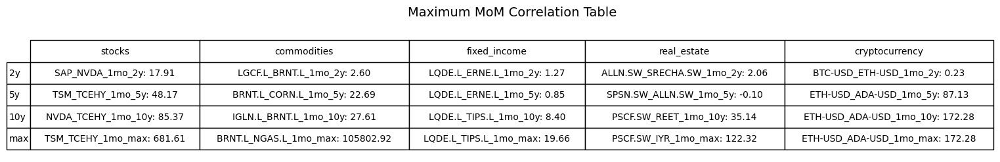

/var/folders/13/wbry88_14llg6vzjyrqprnhr0000gn/T/ipykernel_51168/4085478610.py:17: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  df_numeric = df.applymap(safe_float)


Converted DataFrame (Numeric):
     stocks  commodities  fixed_income  real_estate  cryptocurrency
2y    17.91         2.60          1.27         2.06            0.23
5y    48.17        22.69          0.85        -0.10           87.13
10y   85.37        27.61          8.40        35.14          172.28
max  681.61    105802.92         19.66       122.32          172.28


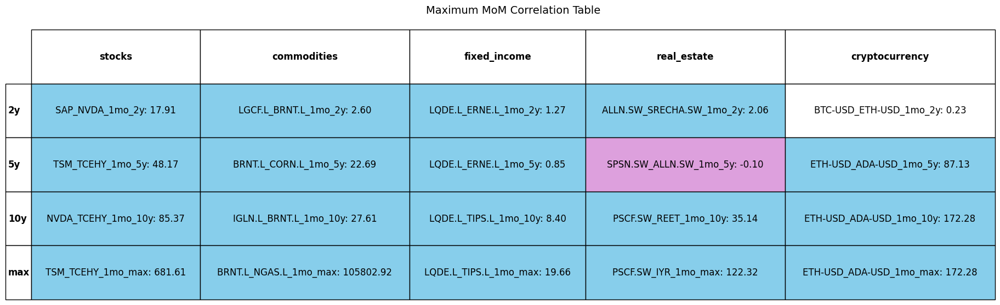

/var/folders/13/wbry88_14llg6vzjyrqprnhr0000gn/T/ipykernel_51168/4085478610.py:17: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  df_numeric = df.applymap(safe_float)


Converted DataFrame (Numeric):
        stocks  commodities  fixed_income  real_estate  cryptocurrency
2y      138.23         3.93          5.69        11.51           61.88
5y      607.98        83.45         -0.75        -3.91         1965.69
10y    4473.53        64.98         19.03        61.70        80572.20
max  906707.25     14760.20         50.80       672.11        80572.20


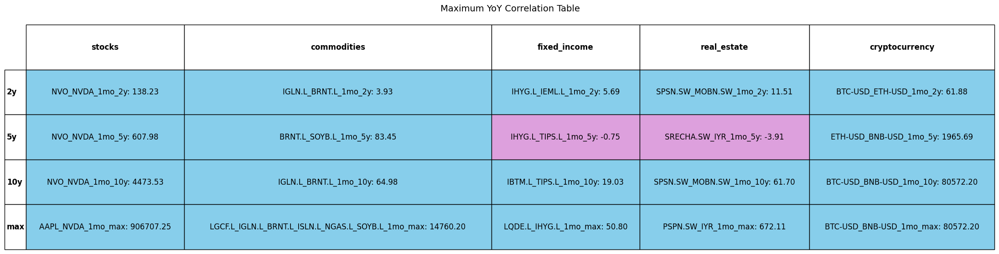

/var/folders/13/wbry88_14llg6vzjyrqprnhr0000gn/T/ipykernel_51168/4085478610.py:17: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  df_numeric = df.applymap(safe_float)


Converted DataFrame (Numeric):
     stocks  commodities  fixed_income  real_estate  cryptocurrency
2y    -6.17        -8.44         -3.59        -3.96          -17.30
5y    -7.30        -7.75         -7.26        -5.30           18.23
10y   -3.94        -4.06         -8.06         6.83           -4.41
max   -2.24       -26.42        -99.27       -81.53          -34.80


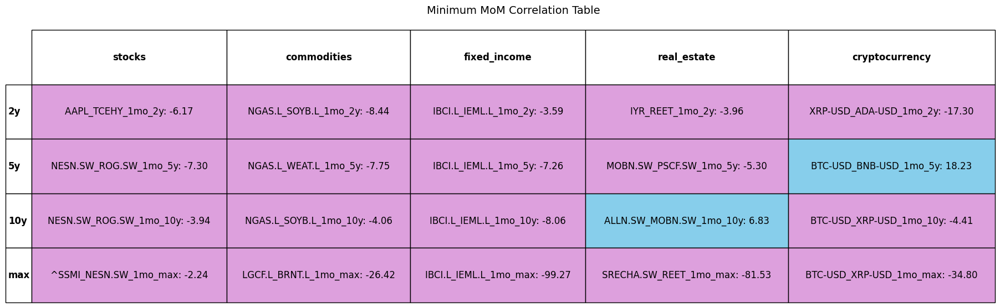

/var/folders/13/wbry88_14llg6vzjyrqprnhr0000gn/T/ipykernel_51168/4085478610.py:17: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  df_numeric = df.applymap(safe_float)


Converted DataFrame (Numeric):
     stocks  commodities  fixed_income  real_estate  cryptocurrency
2y   -18.22       -41.19         -2.74        -4.71            8.60
5y   -15.12       -47.59        -12.33       -15.90          210.03
10y   27.52       -78.25         -7.65        17.30            2.32
max  690.78       -20.42        -20.79        43.71            2.32


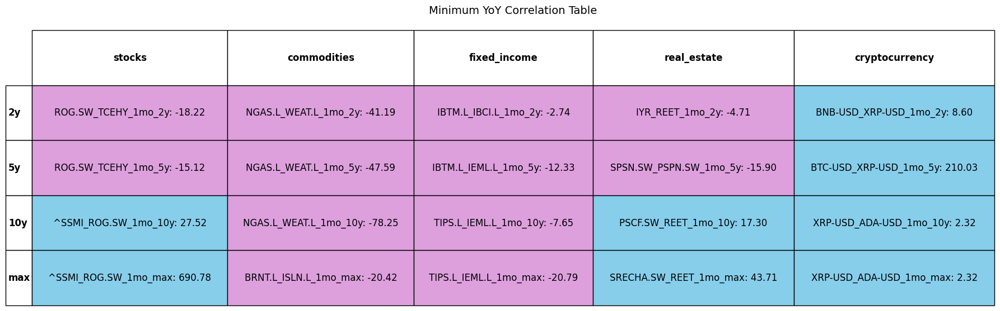

In [101]:
display_table_with_tab(mom_table_max, "Maximum MoM Correlation Table") # Displays in terminal


display_table_as_figure(mom_table_max, "Maximum MoM Correlation Table")
# display_table_as_figure(yoy_table_max, "Maximum YoY Correlation Table")
# display_table_as_figure(mom_table_min, "Minimum MoM Correlation Table")
# display_table_as_figure(yoy_table_min, "Minimum YoY Correlation Table")

# display_table_with_colorscale(mom_table_max, "Maximum MoM Correlation Table")

#Export as PDF

dfs =[
    mom_table_max,
    yoy_table_max,
    mom_table_min,
    yoy_table_min
    
]

titles = ["Maximum MoM Correlation Table" , "Maximum YoY Correlation Table","Minimum MoM Correlation Table", "Minimum YoY Correlation Table" ]

with PdfPages("Results/JPN_All_Possibilities_Real_Returns_Tables_All_Tickers.pdf") as pdf:
    for df, title in zip(dfs, titles):
        # Save each table to the PDF
        display_table_with_colorscale(df, title, pdf)

### Comparison of Results
After running all three methods, we summarize and compare the results to identify trends and insights across the approaches.
It is important to highlight that our analysis prioritizes hedging capabilities—emphasizing safety and risk mitigation—rather than profit potential.

First, we need to make clear which values of each calculation method are more favorable than the others.
- Single-beta linear regression: beta measures the sensitivity of the asset's return to changes in inflation. A beta coefficient of 1 is ideal, indicating the asset's return increase proportionally with inflation.
- Correlation: ideally, we would like to have an asset with correlation coefficient of 1. An asset with a correlation of +1 with inflation directly mirrors inflationary movements. This ensures that the asset's value grows at the same rate as inflation, preserving purchasing power perfectly.
- Real return: we prefer assets with high real returns, because assets which maintain or grow their purchasing power during inflationary periods are better hedges. A consistently positive real return, especially during periods of high inflation, is ideal.

Key Observations:
- **Single-Beta Linear Regression**: Supports the theory that commodities, fixed income, and real estate are effective inflation hedges.
- **Correlation-Based Approach**: Tends to emphasize volatile assets (e.g., cryptocurrencies, stocks).
- **Real Returns**: Less intuitive for the context of inflation hedging.

Based on our research, we focused on the single-beta linear regression methodology for hedging against inflation for Swiss investors, as it aligns closely with economic theories and provides more intuitive results than other methods.

#### Short-Term Inflation Hedging (5-Year Horizon)

- **MoM**: Commodities (IGLN.L and ISLN.L) are favorable.
- **YoY**: Stocks (NESN.SW and NVO) and real estate (SPSN.SW and PSPN.SW) are effective.
- **Strategy**: A mix of commodities, real estate, and stocks provides optimal short-term inflation protection.

#### Medium-Term Inflation Hedging (10-Year Horizon)

- **MoM**: Fixed income (TIPS.L and IEML.L) and real estate (IYR, REET).
- **YoY**: Real estate (PSPN.SW and REET) and fixed income (ERNE.L and TEML.L).
- **Strategy**: A diversified portfolio of real estate and fixed income assets is most effective for medium-term hedging.

#### Long-Term Inflation Hedging (15+ Year Horizon)

- **MoM and YoY**: Real estate consistently recommended (IYR, REET, PSPN.SW).
- **Strategy**: Real estate is the optimal choice for long-term inflation protection.

This analysis highlights asset classes and portfolios that are optimal for different time horizons.


## 4. Conclusion

This study explores the inflation-hedging potential of various asset classes for Swiss investors, including equities, fixed income, real estate, commodities, and cryptocurrencies. Key findings include:
- **Stocks**: Demonstrated uncertain effectiveness as inflation hedges, with correlation decreasing over longer horizons—an unfavorable trend—while beta from linear regression also declined, suggesting a potentially favorable but inconclusive relationship.
- **Commodities**: Demonstrated robust hedging capabilities in short- to medium-term horizons, particularly in year-over-year analysis. They are a flexible and dynamic component of inflation-hedging strategies.
- **Fixed Income**: Inflation-linked bonds provided moderate hedging effectiveness, especially in medium-term horizons. They offer a balanced approach between risk and return. 
- **Real Estate**: Consistently showed strong effectiveness as a long-term hedge against inflation. It is a stable and reliable option for inflation protection across multiple time horizons.
- **Cryptocurrencies**: While showing high real returns during inflationary periods, cryptocurrencies exhibited high volatility and inconsistent correlation with inflation, making them less suitable for conservative inflation protection.

Overall, the study highlights the importance of diversification across asset classes to achieve effective inflation protection while managing risk and return.

#### Limitations:
- **Computational Constraints**: The all-possibilities framework requires significant processing power and limits the number of assets that can be included.
- **Historical Data Limitations**: The reliance on historical data affects comparability across asset classes.
- **Assumptions**: The linear regression model assumes constant relationships, and the exclusion of currency effects may overlook important factors in globally diversified portfolios.

#### Future Research:
- **Advanced Models**: Employing techniques like nonlinear regression or machine learning could provide more accurate models for inflation-hedging.
- **Inflation Decomposition**: Investigating expected and unexpected inflation components may provide deeper insights.
- **Alternative Asset Classes**: Exploring other asset classes, like private equity or infrastructure, could uncover additional opportunities for hedging.
- **Macroeconomic Factors**: Considering currency fluctuations, interest rates, and economic growth could enhance the understanding of inflation-hedging strategies.
